# Corner plots in Altair

I make a lot of corner plots. Let's make them in Altair instead of matplotlib.

In [1]:
import altair as alt
alt.renderers.enable("notebook")
#alt.data_transformers.enable('csv')
alt.data_transformers.enable('default', max_rows=None)
import numpy as np
import pandas as pd

I have a sample file from an MCMC run in the repo:

In [2]:
samples = pd.read_json("gx339_samples.json", orient="records")

In [3]:
samples.head()

,alpha,apl,aqpo,awn,deltanu,nu0
0,1.183746,0.000087,0.003479,0.000317,0.478612,5.630513
1,1.183746,0.000087,0.003479,0.000317,0.478612,5.630513
2,1.177857,0.000088,0.003523,0.000316,0.476530,5.631843
3,1.177857,0.000088,0.003523,0.000316,0.476530,5.631843
4,1.177484,0.000088,0.003514,0.000316,0.476955,5.631585


Let's make some histograms:


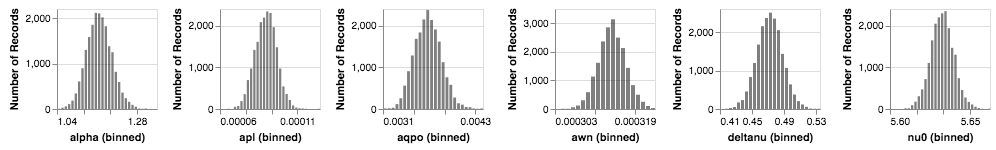

In [6]:
width = 100
height = 100


c_all = []

for label in samples.columns:
    
    chart =  alt.Chart(samples).mark_bar(color="black", opacity=0.5).encode(
                    x = alt.X("%s:Q"%label, bin=alt.Bin(maxbins=30)),
                    y = "count()"
                ).properties(
                    width=width,
                    height=width
                )

    c_all.append(chart)
    
alt.hconcat(*c_all)

Ok, cool. Now let's make a scatter plots:

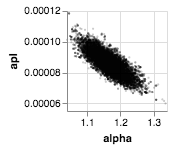

In [8]:
alt.Chart(samples).mark_point(color="black", opacity=0.2, filled=True, size=5).encode(
    x = alt.X("alpha:Q", scale=alt.Scale(zero=False)),
    y = alt.Y("apl:Q", scale=alt.Scale(zero=False))
).properties(
    width=width,
    height=height
)

Can we write a function that makes this nicer?

In [9]:
def plot_scatter(data, columnx, columny, xrange=None, yrange=None, 
                width=100, height=100, extent_factor=0.01, axlabels=None):
    
    """
    Plot a scatter plot in Altair.
    
    Parameters
    ----------
    
    data : pd.DataFrame
        A pandas DataFrame with the data
        
    columnx, columny : str, str
        Strings corresponding to the columns in `data` to be plotted 
        on the x- and y-axis, respectively
        
    nbins : int
        The number of bins on each axis
        
    xrange, yrange : (float, float) or None 
        The ranges for the x- and y-axes. If set to None, will be calculated
        from the data and `extent_factor`
    
    width, height: float, float
        The width and height of the output chart
        
    extent_factor : float, default 0.01
        If `xrange` and/or `yrange` are `None`, this keyword sets a parameter 
        that determines the fraction of space to leave on either side of the 
        min and max of the data points
        
    axlabels : (str, str)
        A list of axis labels for the x- and y-axes. If None, the values 
        in `labelx` and `labely` will be used
        
    Returns
    -------
        hist : alt.Chart object
            The resulting heatmap figure
    """
    # min and max for the x-axis
    if xrange is None:
        min_x = data[columnx].min() * (1.0 - extent_factor)
        max_x = data[columnx].max() * (1.0 + extent_factor)
        xrange = (min_x, max_x)
        
    # min and max for y-axis
    if yrange is None:
        min_y = data[columny].min() * (1.0 - extent_factor)
        max_y = data[columny].max() * (1.0 + extent_factor)
        yrange = (min_y, max_y)
            
    # format for x and y-axis:
    if xrange[1] < 0.01 or xrange[1] > 100:
        xformat = ".1e"
    else:
        xformat = ".3f"
        
    if yrange[1] < 0.01 or yrange[1] > 100:
        yformat = ".1e"
    else:
        yformat = ".3f"
        
    if axlabels is None:
        axlabels = (columnx, columny)
    
    scatter = alt.Chart(data).mark_point(color="black", opacity=0.2, filled=True, size=5).encode(
    x = alt.X('%s:Q'%columnx, axis=alt.Axis(format="%s"%xformat, labelAngle=-45), 
              scale=alt.Scale(zero=False, nice=False, domain=xrange), title=axlabels[0]),
    y = alt.Y('%s:Q'%columny, axis=alt.Axis(format="%s"%yformat, labelAngle=-45), 
              scale=alt.Scale(zero=False, nice=False,  domain=yrange), title=axlabels[1])
).properties(
    width=width,
    height=height
)
   
    return scatter

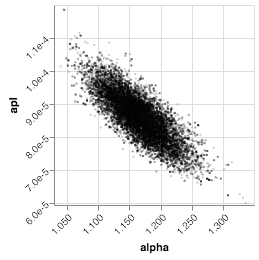

In [10]:
scatter = plot_scatter(samples, "alpha", "apl", width=200, height=200)

scatter

The scatter plot isn't ideal How about a heat map?

In [69]:
def plot_hist2d(data, columnx, columny, nbins=20, xrange=None, yrange=None, 
                width=100, height=100, extent_factor=0.01, axlabels=None):
    
    """
    Plot a 2D histogram in Altair with a fixed number of bins.
    
    Parameters
    ----------
    
    data : pd.DataFrame
        A pandas DataFrame with the data
        
    columnx, columny : str, str
        Strings corresponding to the columns in `data` to be plotted 
        on the x- and y-axis, respectively
        
    nbins : int
        The number of bins on each axis
        
    xrange, yrange : (float, float) or None 
        The ranges for the x- and y-axes. If set to None, will be calculated
        from the data and `extent_factor`
    
    width, height: float, float
        The width and height of the output chart
        
    extent_factor : float, default 0.01
        If `xrange` and/or `yrange` are `None`, this keyword sets a parameter 
        that determines the fraction of space to leave on either side of the 
        min and max of the data points
        
    axlabels : (str, str)
        The labels for the x- and y-axis, respectively. If `None`, the axis 
        labels will be taken from `columnx` and `columny`.
        
    Returns
    -------
        hist : alt.Chart object
            The resulting heatmap figure
    """
    # min and max for the x-axis
    if xrange is None:
        min_x = data[columnx].min() * (1.0 - extent_factor)
        max_x = data[columnx].max() * (1.0 + extent_factor)
        xrange = (min_x, max_x)
        
    # min and max for y-axis
    if yrange is None:
        min_y = data[columny].min() * (1.0 - extent_factor)
        max_y = data[columny].max() * (1.0 + extent_factor)
        yrange = (min_y, max_y)
        
    xstep = (xrange[1]-xrange[0])/(nbins)
    ystep = (yrange[1]-yrange[0])/(nbins)
        
    # bins are bin _edges_, so need to be nbins+1
    xbins = np.arange(xrange[0], xrange[1]+0.5*xstep, xstep)
    ybins = np.arange(yrange[0], yrange[1]+0.5*ystep, ystep)

    # grid for the 2D histogram
    x, y = np.meshgrid(xbins[:-1], ybins[:-1])

    # create the 2D histogram
    hist, xedges, yedges = np.histogram2d(data[columnx], data[columny], bins=[xbins, ybins])

    # unravel the x- and y-bins
    xravel = x.ravel()
    yravel = y.ravel()

    # unravel the histogram
    histravel = hist.ravel()

    # put everything into a temporary DataFrame
    histdf = pd.DataFrame({"%s"%columnx:xravel, "%s"%columny:yravel, "hist":histravel})
    
    # format for x and y-axis:
    if xrange[1] < 0.01 or xrange[1] > 100:
        xformat = ".1e"
    else:
        xformat = ".3f"
        
    if yrange[1] < 0.01 or yrange[1] > 100:
        yformat = ".1e"
    else:
        yformat = ".3f"
        
    # get the axis labels
    if axlabels is None:
        axlabels = (columnx, columny)
    
    # make the plot
    hist = alt.Chart(histdf).mark_rect().encode(
                x=alt.X('%s:Q'%columnx, axis=alt.Axis(format="%s"%xformat, labelAngle=-45), 
                        bin=alt.Bin(step=(xrange[1]-xrange[0])/nbins), title=axlabels[0]),
                y=alt.Y('%s:Q'%columny, axis=alt.Axis(format="%s"%yformat, labelAngle=-45), 
                        bin=alt.Bin(step=(yrange[1]-yrange[0])/nbins), title=axlabels[1]),
                color=alt.Color('hist:Q', scale=alt.Scale(scheme="greys"), legend=None)
            ).properties(
                width=width,
                height=height
            )
    return hist

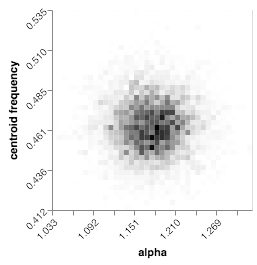

In [70]:
hist = plot_hist2d(samples, "alpha", "deltanu", nbins=40, xrange=None, yrange=None, 
                width=200, height=200, extent_factor=0.0, axlabels=["alpha", "centroid frequency"])

hist

Can we combine some of those?

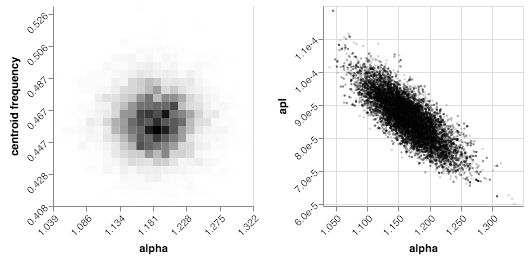

In [72]:
alt.hconcat(hist, scatter)

What about a function for the 1D-histogram we made earlier?

In [73]:
def plot_hist1d(data, label, nbins=20, xrange=None, 
                width=100, height=100, axlabel=None):
    
    """
    Plot a 2D histogram in Altair with a fixed number of bins.
    
    Parameters
    ----------
    
    data : pd.DataFrame
        A pandas DataFrame with the data
        
    labelx, labely : str, str
        Strings corresponding to the columns in `data` to be plotted 
        on the x- and y-axis, respectively
        
    nbins : int
        The number of bins on each axis
        
    xrange, yrange : (float, float) or None 
        The ranges for the x- and y-axes. If set to None, will be calculated
        from the data and `extent_factor`
    
    width, height: float, float
        The width and height of the output chart
        
    extent_factor : float, default 0.01
        If `xrange` and/or `yrange` are `None`, this keyword sets a parameter 
        that determines the fraction of space to leave on either side of the 
        min and max of the data points
        
    axlabel : str
        The text for the x-axis (instead of the string in `label`)
        
    Returns
    -------
        hist : alt.Chart object
            The resulting heatmap figure
    """
    # min and max for the x-axis
    if xrange is None:
        min_x = data[label].min()
        max_x = data[label].max()
        xrange = (min_x, max_x)
                
    xstep = (xrange[1]-xrange[0])/(nbins+1)
        
    # format for x and y-axis:
    if xrange[1] < 0.01 or xrange[1] > 100:
        xformat = ".1e"
    else:
        xformat = ".3f"

    if axlabel is None:
        axlabel = label
        
    # make the plot
    hist = alt.Chart(data).mark_bar(color="black", opacity=0.5).encode(
                x=alt.X('%s:Q'%label, axis=alt.Axis(format="%s"%xformat, labelAngle=-45), 
                        bin=alt.Bin(step=xstep), title=axlabel, scale=alt.Scale(domain=xrange, nice=True)),
        
                y=alt.Y("count()", title="Number of samples", axis=alt.Axis(format="f", labelAngle=-45))
            ).properties(
                width=width,
                height=height
            )
    return hist

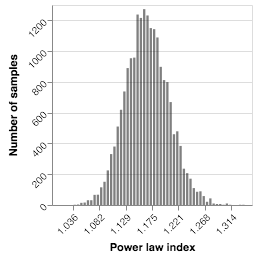

In [74]:
label = "alpha"
nbins = 50

hist = plot_hist1d(samples, label, nbins=nbins, width=200, height=200, axlabel="Power law index")

hist

Okay, now we can put those together in a corner plot:

In [75]:
def corner(data, nbins=40, axlabels=None, width=100, height=100):
    if axlabels is None:
        axlabels = np.array(data.columns)

    c_hconcat_all = []

    for i,labelx in enumerate(data.columns):
        c_row = []
        min_x = data[labelx].min()
        max_x = data[labelx].max()
        for j, labely in enumerate(data.columns):
            if labelx == labely:
                chart = plot_hist1d(data, labelx, nbins=nbins, xrange=(min_x, max_x), 
                                    width=width, height=height, axlabel=axlabels[i])
                c_row.append(chart)
            elif j > i:
                chart = alt.Chart()
            else:
                min_y = data[labely].min()
                max_y = data[labely].max()

                al = (axlabels[j], axlabels[i])

                chart = plot_hist2d(data, labely, labelx, nbins=nbins, 
                                    xrange=(min_y, max_y), yrange=(min_x, max_x),
                                    width=width, height=height, extent_factor=0.0,
                                    axlabels=al)
                c_row.append(chart)
        c_hconcat = alt.hconcat(*c_row)
        c_hconcat_all.append(c_hconcat)

    cplot = alt.vconcat(*c_hconcat_all)
    
    return cplot

Let's make a small one first:

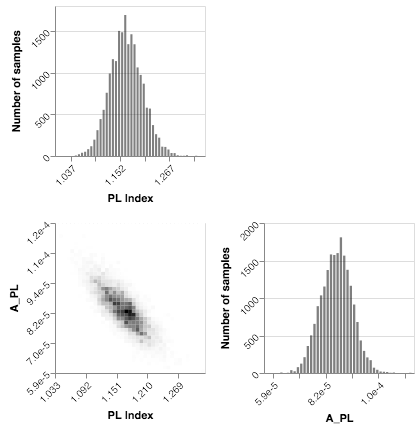

In [76]:
corner(samples[["alpha", "apl"]], nbins=40, axlabels=["PL Index", "A_PL"], width=150, height=150)

Awesome. Now let's make the full one:

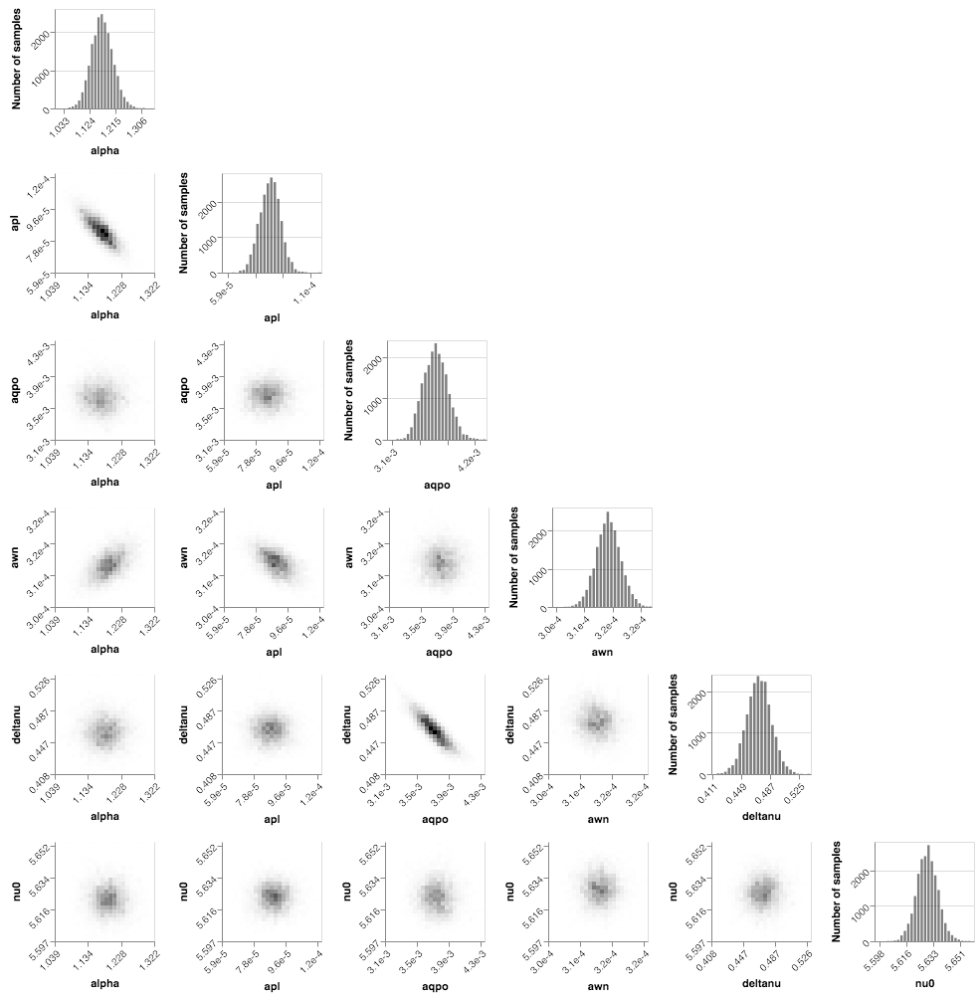

In [77]:
corner(samples, nbins=25, width=100, height=100)